## MultiModal LLMs

Ref: https://www.analyticsvidhya.com/blog/2023/11/kosmos-2-a-multimodal-large-language-model-by-microsoft/

### KOSMOS-2: A Multimodal Large Language Model by Microsoft

KOSMOS-2 is built on a Transformer-based causal language model architecture

Recap: Causal LM vs Masked LM
- Causal LM: Predicts the next token given the previous tokens
- Masked LM: Predicts the masked token given the surrounding tokens

However, what sets KOSMOS-2 apart is its unique training process. It is trained on a vast dataset of grounded image-text pairs known as GRIT, where text contains references to objects in images in the form of bounding boxes as special tokens. This innovative approach allows KOSMOS-2 to provide a new understanding of text and images.

What is Multimodal Grounding?

One of the standout features of KOSMOS-2 is its ability to perform “multimodal grounding.” This means that it can generate captions for images that describe the objects and their location within the image. This reduces “hallucinations,” a common issue in language models, dramatically improving the model’s accuracy and reliability.

This concept connects text to objects in images through unique tokens, effectively “grounding” the objects in the visual context. This reduces hallucinations and enhances the model’s ability to generate accurate image captions.

Referring Expression Generation

KOSMOS-2 also excels in “referring expression generation.” This feature lets users prompt the model with a specific bounding box in an image and a question. The model can then answer questions about specific locations in the image, providing a powerful tool for understanding and interpreting visual content.

![title](https://camo.githubusercontent.com/6be1201ae2b4ccab2f3f585b9fa3086f831703c5e1289f3aba0bab6ac7111eab/68747470733a2f2f68756767696e67666163652e636f2f64617461736574732f68756767696e67666163652f646f63756d656e746174696f6e2d696d616765732f7265736f6c76652f6d61696e2f7472616e73666f726d6572732f6d6f64656c5f646f632f6b6f736d6f735f325f6172636869746563747572652e6a7067)

In [1]:
import random
import numpy as np
import os
import requests
import torch
import torchvision.transforms as T
from PIL import Image
from transformers import AutoProcessor, AutoModelForVision2Seq
import cv2
import ast
from IPython.display import display, HTML

### Code Ref: https://huggingface.co/spaces/ydshieh/Kosmos-2/tree/main

In [2]:
ckpt = "microsoft/kosmos-2-patch14-224"
device = torch.device("cpu" if not torch.cuda.is_available() else "cuda")

model = AutoModelForVision2Seq.from_pretrained(ckpt, cache_dir="/projectnb/ds598/admin/xthomas/sp2024_notebooks/discussion/tmp").to(device)
processor = AutoProcessor.from_pretrained(ckpt, cache_dir="/projectnb/ds598/admin/xthomas/sp2024_notebooks/discussion/tmp")

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


In [3]:
colors = [
    (0, 255, 0),
    (0, 0, 255),
    (255, 255, 0),
    (255, 0, 255),
    (0, 255, 255),
    (114, 128, 250),
    (0, 165, 255),
    (0, 128, 0),
    (144, 238, 144),
    (238, 238, 175),
    (255, 191, 0),
    (0, 128, 0),
    (226, 43, 138),
    (255, 0, 255),
    (0, 215, 255),
    (255, 0, 0),
]

color_map = {
    f"{color_id}": f"#{hex(color[2])[2:].zfill(2)}{hex(color[1])[2:].zfill(2)}{hex(color[0])[2:].zfill(2)}" for color_id, color in enumerate(colors)
}


def is_overlapping(rect1, rect2):
    x1, y1, x2, y2 = rect1
    x3, y3, x4, y4 = rect2
    return not (x2 < x3 or x1 > x4 or y2 < y3 or y1 > y4)


def draw_entity_boxes_on_image(image, entities, show=False, save_path=None, entity_index=-1):
    """_summary_
    Args:
        image (_type_): image or image path
        collect_entity_location (_type_): _description_
    """
    if isinstance(image, Image.Image):
        image_h = image.height
        image_w = image.width
        image = np.array(image)[:, :, [2, 1, 0]]
    elif isinstance(image, str):
        if os.path.exists(image):
            pil_img = Image.open(image).convert("RGB")
            image = np.array(pil_img)[:, :, [2, 1, 0]]
            image_h = pil_img.height
            image_w = pil_img.width
        else:
            raise ValueError(f"invaild image path, {image}")
    elif isinstance(image, torch.Tensor):
        # pdb.set_trace()
        image_tensor = image.cpu()
        reverse_norm_mean = torch.tensor([0.48145466, 0.4578275, 0.40821073])[:, None, None]
        reverse_norm_std = torch.tensor([0.26862954, 0.26130258, 0.27577711])[:, None, None]
        image_tensor = image_tensor * reverse_norm_std + reverse_norm_mean
        pil_img = T.ToPILImage()(image_tensor)
        image_h = pil_img.height
        image_w = pil_img.width
        image = np.array(pil_img)[:, :, [2, 1, 0]]
    else:
        raise ValueError(f"invaild image format, {type(image)} for {image}")

    if len(entities) == 0:
        print("No entities found in the image")
        return image

    indices = list(range(len(entities)))
    if entity_index >= 0:
        indices = [entity_index]

    # Not to show too many bboxes
    entities = entities[:len(color_map)]

    new_image = image.copy()
    previous_bboxes = []
    # size of text
    text_size = 1
    # thickness of text
    text_line = 1  # int(max(1 * min(image_h, image_w) / 512, 1))
    box_line = 3
    (c_width, text_height), _ = cv2.getTextSize("F", cv2.FONT_HERSHEY_COMPLEX, text_size, text_line)
    base_height = int(text_height * 0.675)
    text_offset_original = text_height - base_height
    text_spaces = 3

    # num_bboxes = sum(len(x[-1]) for x in entities)
    used_colors = colors  # random.sample(colors, k=num_bboxes)

    color_id = -1
    for entity_idx, (entity_name, (start, end), bboxes) in enumerate(entities):
        color_id += 1
        if entity_idx not in indices:
            continue
        for bbox_id, (x1_norm, y1_norm, x2_norm, y2_norm) in enumerate(bboxes):
            # if start is None and bbox_id > 0:
            #     color_id += 1
            orig_x1, orig_y1, orig_x2, orig_y2 = int(x1_norm * image_w), int(y1_norm * image_h), int(x2_norm * image_w), int(y2_norm * image_h)

            # draw bbox
            # random color
            color = used_colors[color_id]  # tuple(np.random.randint(0, 255, size=3).tolist())
            new_image = cv2.rectangle(new_image, (orig_x1, orig_y1), (orig_x2, orig_y2), color, box_line)

            l_o, r_o = box_line // 2 + box_line % 2, box_line // 2 + box_line % 2 + 1

            x1 = orig_x1 - l_o
            y1 = orig_y1 - l_o

            if y1 < text_height + text_offset_original + 2 * text_spaces:
                y1 = orig_y1 + r_o + text_height + text_offset_original + 2 * text_spaces
                x1 = orig_x1 + r_o

            # add text background
            (text_width, text_height), _ = cv2.getTextSize(f"  {entity_name}", cv2.FONT_HERSHEY_COMPLEX, text_size, text_line)
            text_bg_x1, text_bg_y1, text_bg_x2, text_bg_y2 = x1, y1 - (text_height + text_offset_original + 2 * text_spaces), x1 + text_width, y1

            for prev_bbox in previous_bboxes:
                while is_overlapping((text_bg_x1, text_bg_y1, text_bg_x2, text_bg_y2), prev_bbox):
                    text_bg_y1 += (text_height + text_offset_original + 2 * text_spaces)
                    text_bg_y2 += (text_height + text_offset_original + 2 * text_spaces)
                    y1 += (text_height + text_offset_original + 2 * text_spaces)

                    if text_bg_y2 >= image_h:
                        text_bg_y1 = max(0, image_h - (text_height + text_offset_original + 2 * text_spaces))
                        text_bg_y2 = image_h
                        y1 = image_h
                        break

            alpha = 0.5
            for i in range(text_bg_y1, text_bg_y2):
                for j in range(text_bg_x1, text_bg_x2):
                    if i < image_h and j < image_w:
                        if j < text_bg_x1 + 1.35 * c_width:
                            # original color
                            bg_color = color
                        else:
                            # white
                            bg_color = [255, 255, 255]
                        new_image[i, j] = (alpha * new_image[i, j] + (1 - alpha) * np.array(bg_color)).astype(np.uint8)

            cv2.putText(
                new_image, f"  {entity_name}", (x1, y1 - text_offset_original - 1 * text_spaces), cv2.FONT_HERSHEY_COMPLEX, text_size, (0, 0, 0), text_line, cv2.LINE_AA
            )
            # previous_locations.append((x1, y1))
            previous_bboxes.append((text_bg_x1, text_bg_y1, text_bg_x2, text_bg_y2))

    pil_image = Image.fromarray(new_image[:, :, [2, 1, 0]])
    if save_path:
        pil_image.save(save_path)
    if show:
        pil_image.show()

    return pil_image

In [6]:
def generate_predictions(image_input, text_input):

        # Save the image and load it again to match the original Kosmos-2 demo.
        # (https://github.com/microsoft/unilm/blob/f4695ed0244a275201fff00bee495f76670fbe70/kosmos-2/demo/gradio_app.py#L345-L346)
        user_image_path = "/projectnb/ds598/admin/xthomas/sp2024_notebooks/discussion/tmp/imgs/snowman.png"
        image_input.save(user_image_path)
        # This might give different results from the original argument `image_input`
        image_input = Image.open(user_image_path)

        inputs = processor(text=text_input, images=image_input, return_tensors="pt").to(device)

        generated_ids = model.generate(
            pixel_values=inputs["pixel_values"],
            input_ids=inputs["input_ids"],
            attention_mask=inputs["attention_mask"],
            image_embeds=None,
            image_embeds_position_mask=inputs["image_embeds_position_mask"],
            use_cache=True,
            max_new_tokens=128,
        )

        generated_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0]

        # By default, the generated  text is cleanup and the entities are extracted.
        processed_text, entities = processor.post_process_generation(generated_text)

        annotated_image = draw_entity_boxes_on_image(image_input, entities, show=False)

        color_id = -1
        entity_info = []
        filtered_entities = []
        for entity in entities:
            entity_name, (start, end), bboxes = entity
            if start == end:
                # skip bounding bbox without a `phrase` associated
                continue
            color_id += 1
            # for bbox_id, _ in enumerate(bboxes):
                # if start is None and bbox_id > 0:
                #     color_id += 1
            entity_info.append(((start, end), color_id))
            filtered_entities.append(entity)
                
        colored_text = []
        prev_start = 0
        end = 0
        font_size = "18px"  # You can change this value as needed

        for ((start, end), color_id) in entity_info:
            color_code = color_map[str(color_id)]  # Fetch color code from color_map using color_id
            if start > prev_start:
                colored_text.append(f"<span style='font-size: {font_size};'>{processed_text[prev_start:start]}</span>")
            colored_text.append(f"<span style='color: {color_code}; font-size: {font_size};'>{processed_text[start:end]}</span>")
            prev_start = end

        if end < len(processed_text):
            colored_text.append(f"<span style='font-size: {font_size};'>{processed_text[end:]}</span>")

        return annotated_image, colored_text, str(filtered_entities)

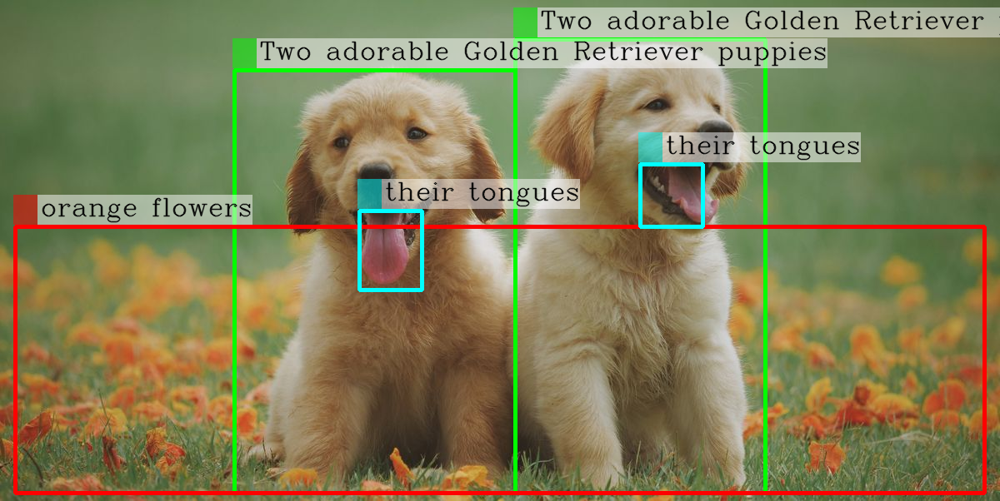

In [7]:

text_input = "<grounding>Describe this image in detail:"
img, colored_text, entities = generate_predictions(Image.open("/projectnb/ds598/admin/xthomas/sp2024_notebooks/discussion/tmp/imgs/snowman.png"), text_input=text_input)
img

In [8]:

html_text = ''.join(colored_text)
# Display the colored text in Jupyter Notebook
display(HTML(html_text))

In [9]:
entities

"[('Two adorable Golden Retriever puppies', (31, 68), [(0.515625, 0.078125, 0.765625, 0.984375), (0.234375, 0.140625, 0.515625, 0.984375)]), ('orange flowers', (100, 114), [(0.015625, 0.453125, 0.984375, 0.984375)]), ('their tongues', (157, 170), [(0.359375, 0.421875, 0.421875, 0.578125), (0.640625, 0.328125, 0.703125, 0.453125)])]"

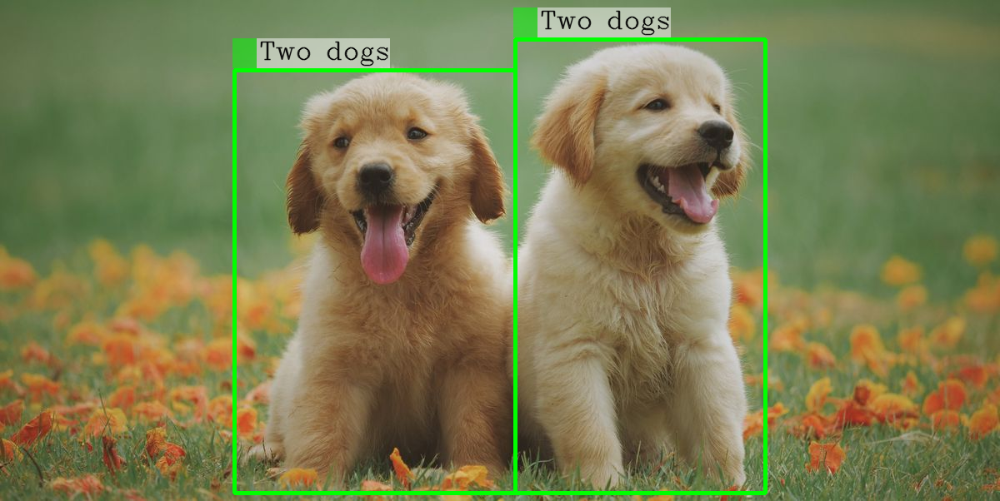

In [10]:
text_input = "<grounding>Question: How many dogs in the image? Answer:"
img, colored_text, entities = generate_predictions(Image.open("/projectnb/ds598/admin/xthomas/sp2024_notebooks/discussion/tmp/imgs/two_dogs.jpg"), text_input=text_input)
img

In [11]:
# Joining all parts of the text to a single HTML string
html_text = ''.join(colored_text)

# Display the colored text in Jupyter Notebook
display(HTML(html_text))

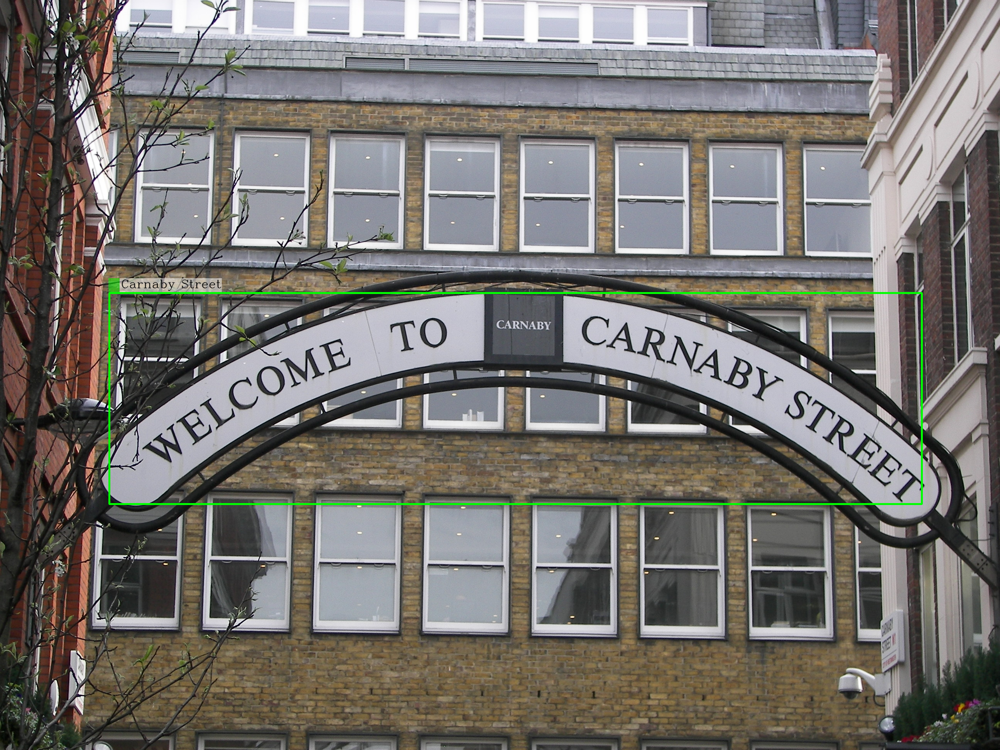

In [12]:
text_input = "<grounding>Question: What is written on the board? Answer:"
img, colored_text, entities = generate_predictions(Image.open("/projectnb/ds598/admin/xthomas/sp2024_notebooks/discussion/tmp/imgs/carnaby_street.jpg"), text_input=text_input)
img

In [13]:
# Joining all parts of the text to a single HTML string
html_text = ''.join(colored_text)

# Display the colored text in Jupyter Notebook
display(HTML(html_text))

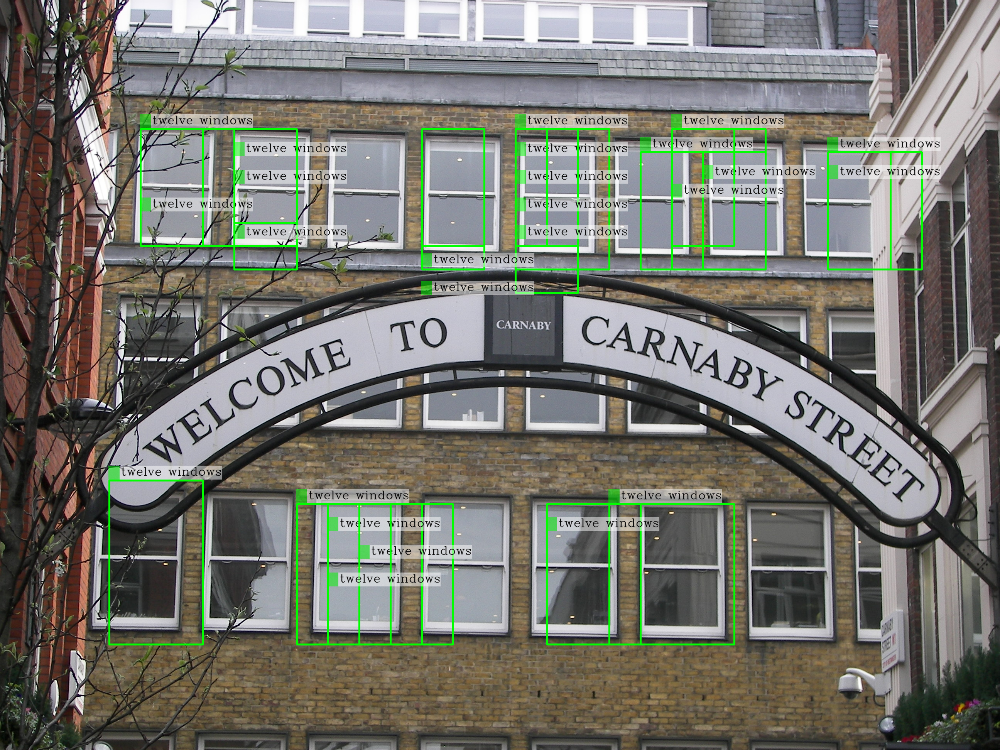

In [14]:
text_input = "<grounding>Question: How many number of windows on the building? Answer:"
img, colored_text, entities = generate_predictions(Image.open("/projectnb/ds598/admin/xthomas/sp2024_notebooks/discussion/tmp/imgs/carnaby_street.jpg"), text_input=text_input)
img

In [ ]:
# Joining all parts of the text to a single HTML string
html_text = ''.join(colored_text)

# Display the colored text in Jupyter Notebook
display(HTML(html_text))

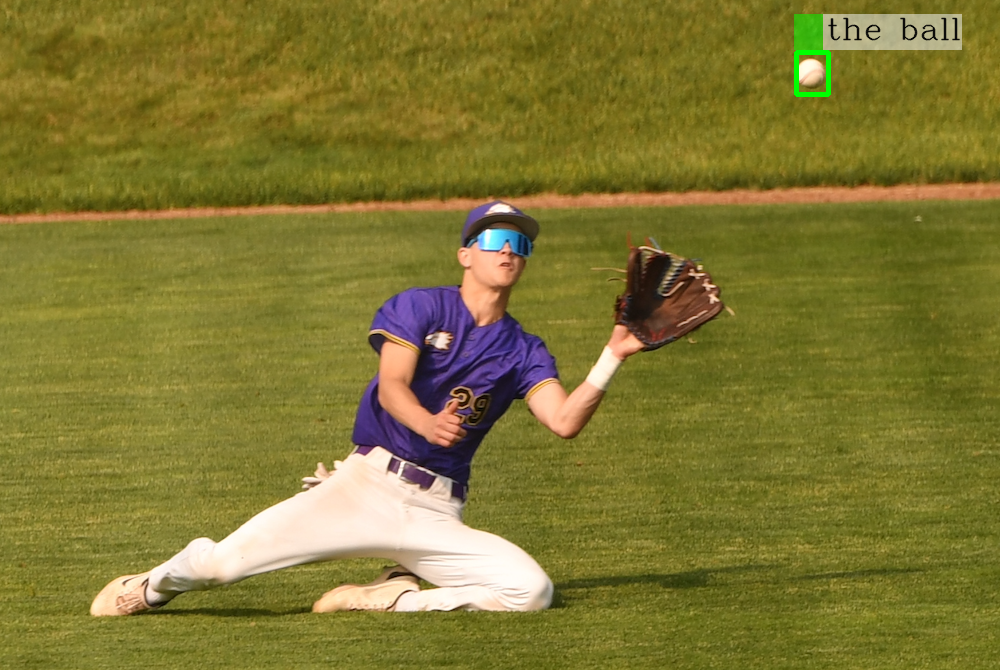

In [16]:
text_input = "<grounding>Question: What is the person doing? Answer: The person is"
img, colored_text, entities = generate_predictions(Image.open("/projectnb/ds598/admin/xthomas/sp2024_notebooks/discussion/tmp/imgs/man_ball.png"), text_input=text_input)
img

In [17]:
# Joining all parts of the text to a single HTML string
html_text = ''.join(colored_text)

# Display the colored text in Jupyter Notebook
display(HTML(html_text))